# Overview
The goal of this competition is to predict which clients are more likely to default on their loans. </br>
The evaluation will favor solutions that are stable over time.

# Evaluation
Submissions are evaluated using a gini stability metric. A gini score is calculated for predictions corresponding to each WEEK_NUM.

gini = 2∗AUC−1

In [3]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import warnings
import os

# Suppress all warnings
warnings.filterwarnings("ignore")

# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

In [5]:
#Importing libraries
import polars as pl
import polars.selectors as cs
import pandas as pd
import numpy as np
import seaborn as sns


from glob import glob
from random import shuffle
import copy
import random
from tqdm import tqdm
import missingno as msno # For visualization on missing values.

import shap

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.experimental import enable_iterative_imputer, enable_halving_search_cv
from sklearn.impute import SimpleImputer, IterativeImputer
from sklearn.model_selection import train_test_split, GridSearchCV, HalvingRandomSearchCV
from sklearn.metrics import roc_auc_score, roc_curve, RocCurveDisplay, auc
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression

from imblearn.over_sampling import SMOTE 

import lightgbm as lgb

import matplotlib.pyplot as plt
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"


In [6]:
base_path = "/kaggle/input/home-credit-credit-risk-model-stability/"
train_path = os.path.join(base_path, "parquet_files/train")
test_path = os.path.join(base_path, "parquet_files/test")

In [7]:
#feature definitions
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

feature_desc_df = pl.read_csv(os.path.join(base_path, "feature_definitions.csv"))
feature_desc_df

Variable,Description
str,str
"""actualdpd_943P…","""Days Past Due …"
"""actualdpdtoler…","""DPD of client …"
"""addres_distric…","""District of th…"
"""addres_role_87…","""Role of person…"
"""addres_zip_823…","""Zip code of th…"
"""amount_1115A""","""Credit amount …"
"""amount_416A""","""Deposit amount…"
"""amount_4527230…","""Tax deductions…"
"""amount_4917619…","""Tax deductions…"


In [8]:
def list_files_in_directory(directory):
    """
    List all files in the specified directory and return them as a list,
    along with the total number of files and their order.
    
    Args:
    - directory: A string representing the path to the directory.
    
    Returns:
    - file_list: A list containing the names of all files in the directory.
    - total_files: An integer representing the total number of files in the directory.
    """
    # Initialize a list to store file names
    file_list = []

    # Initialize a counter for the total number of files
    total_files = 0

    # Iterate through the files in the directory
    for root, dirs, files in os.walk(directory):
        for file in files:
            total_files += 1
            file_list.append(file)

    # Print the total number of files
    print("Total number of files in {}: {}".format(directory, total_files))

    # Print all the files in the list along with their order
    for i, file in enumerate(file_list, 1):
        print(f"{i}: {file}")
    #return file_list

In [9]:
list_files_in_directory(train_path)
list_files_in_directory(test_path)

Total number of files in /kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train: 32
1: train_tax_registry_c_1.parquet
2: train_static_0_0.parquet
3: train_credit_bureau_a_1_3.parquet
4: train_credit_bureau_b_2.parquet
5: train_applprev_1_1.parquet
6: train_static_cb_0.parquet
7: train_other_1.parquet
8: train_credit_bureau_a_2_6.parquet
9: train_tax_registry_a_1.parquet
10: train_tax_registry_b_1.parquet
11: train_credit_bureau_a_2_1.parquet
12: train_person_1.parquet
13: train_person_2.parquet
14: train_credit_bureau_b_1.parquet
15: train_credit_bureau_a_2_0.parquet
16: train_credit_bureau_a_2_7.parquet
17: train_deposit_1.parquet
18: train_debitcard_1.parquet
19: train_credit_bureau_a_2_5.parquet
20: train_credit_bureau_a_2_2.parquet
21: train_credit_bureau_a_2_4.parquet
22: train_base.parquet
23: train_credit_bureau_a_2_9.parquet
24: train_credit_bureau_a_2_3.parquet
25: train_applprev_2.parquet
26: train_credit_bureau_a_2_10.parquet
27: train_credit_bureau_a_2_8.

## Step 1: Explore Base tables

In [10]:
# Explore the base table for both train and test
base_train= pd.read_parquet(train_path+"/train_base.parquet")
base_test= pd.read_parquet(test_path+"/test_base.parquet")

In [11]:
print("Training data: head,shape,info")

base_train.head()
base_train.tail()
base_train.shape
base_train.info()
print("----------------------------------------------------------")
print("----------------------------------------------------------")

print("Testing data: head,shape,info")

base_test.head()
base_test.tail()
base_test.shape
base_test.info()

Training data: head,shape,info


,case_id,date_decision,MONTH,WEEK_NUM,target
0,0,2019-01-03,201901,0,0
1,1,2019-01-03,201901,0,0
2,2,2019-01-04,201901,0,0
3,3,2019-01-03,201901,0,0
4,4,2019-01-04,201901,0,1


,case_id,date_decision,MONTH,WEEK_NUM,target
1526654,2703450,2020-10-05,202010,91,0
1526655,2703451,2020-10-05,202010,91,0
1526656,2703452,2020-10-05,202010,91,0
1526657,2703453,2020-10-05,202010,91,0
1526658,2703454,2020-10-05,202010,91,0


(1526659, 5)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1526659 entries, 0 to 1526658
Data columns (total 5 columns):
 #   Column         Non-Null Count    Dtype 
---  ------         --------------    ----- 
 0   case_id        1526659 non-null  int64 
 1   date_decision  1526659 non-null  object
 2   MONTH          1526659 non-null  int64 
 3   WEEK_NUM       1526659 non-null  int64 
 4   target         1526659 non-null  int64 
dtypes: int64(4), object(1)
memory usage: 58.2+ MB
----------------------------------------------------------
----------------------------------------------------------
Testing data: head,shape,info


,case_id,date_decision,MONTH,WEEK_NUM
0,57543,2021-05-14,202201,100
1,57549,2022-01-17,202201,100
2,57551,2020-11-27,202201,100
3,57552,2020-11-27,202201,100
4,57569,2021-12-20,202201,100


,case_id,date_decision,MONTH,WEEK_NUM
5,57630,2021-03-16,202201,100
6,57631,2022-06-04,202201,100
7,57632,2022-02-05,202201,100
8,57633,2022-01-25,202201,100
9,57634,2021-01-27,202201,100


(10, 4)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   case_id        10 non-null     int64 
 1   date_decision  10 non-null     object
 2   MONTH          10 non-null     int64 
 3   WEEK_NUM       10 non-null     int64 
dtypes: int64(3), object(1)
memory usage: 448.0+ bytes


In [12]:
#check if there are any missing values
base_train.isnull().sum()
base_test.isnull().sum()

case_id          0
date_decision    0
MONTH            0
WEEK_NUM         0
target           0
dtype: int64

case_id          0
date_decision    0
MONTH            0
WEEK_NUM         0
dtype: int64

In [13]:
def transform_dtypes(df):
    """
    Transform the data types of columns in a DataFrame based on predefined rules.
    
    Args:
    - df: The DataFrame whose columns' data types are to be transformed.
    
    Returns:
    - df: The DataFrame with transformed data types.
    """
    # Define the data type transformations
    dtype_transformations = {
        "date_decision": "datetime64[ns]",
        "case_id": "int64",
        "WEEK_NUM": "int64",
        "num_group1": "int64",
        "num_group2": "int64"
    }
    
    dtype_mapping = {
        "A": "float32",
        "P": "float32",
        "D": "datetime64[ns]",
        "M": "category",
        "L": "category",
        "T": "category"
    }
    
    
    for col, dtype in dtype_transformations.items():
        if col in df.columns:
            df[col] = df[col].astype(dtype)
            
    # Define suffix-based data type mappings
    for col in df.columns:
        suffix = col[-1]
        if suffix in dtype_mapping:
            df[col] = df[col].astype(dtype_mapping[suffix])
    
    return df

In [14]:
def convert_strings(df):
    """
    Convert string columns in a DataFrame to categorical 
    data type with "Unknown" category for missing values
    """
    for col in df.columns:  
        # Check if column dtype is string or object
        if df[col].dtype.name in ['object', 'string']:
            # Convert string column to categorical data type
            df[col] = df[col].astype("string").astype('category')
            # Add "Unknown" category for missing values
            current_categories = df[col].cat.categories
            new_categories = current_categories.to_list() + ["Unknown"]
            new_dtype = pd.CategoricalDtype(categories=new_categories, ordered=True)
            df[col] = df[col].astype(new_dtype)
    return df

In [16]:
def handle_dates(df):
    # modified from code created by Farukcan Saglam for this competition
    for col in df.columns:
        if col[0].islower and col[-1] in ("D",):
            df = df.with_columns(pl.col(col) - pl.col("date_decision"))
            df = df.with_columns(pl.col(col).dt.total_days())
            df = df.with_columns(pl.col(col).cast(pl.Float32))
    df = df.drop("date_decision",)
    return df

In [17]:
#perform data type transformation on the base tables
train_base=transform_dtypes(base_train)
train_base= convert_strings(base_train)

test_base= transform_dtypes(base_test)
test_base= convert_strings(base_test)

In [18]:
train_base.head()
test_base.head()

,case_id,date_decision,MONTH,WEEK_NUM,target
0,0,2019-01-03,201901,0,0
1,1,2019-01-03,201901,0,0
2,2,2019-01-04,201901,0,0
3,3,2019-01-03,201901,0,0
4,4,2019-01-04,201901,0,1


,case_id,date_decision,MONTH,WEEK_NUM
0,57543,2021-05-14,202201,100
1,57549,2022-01-17,202201,100
2,57551,2020-11-27,202201,100
3,57552,2020-11-27,202201,100
4,57569,2021-12-20,202201,100


<Figure size 600x400 with 0 Axes>

<Axes: xlabel='target'>

Text(0.5, 1.0, 'Distribution of target')

Text(0.5, 0, 'target')

Text(0, 0.5, 'Frequency')

(array([0, 1]), [Text(0, 0, '0'), Text(1, 0, '1')])

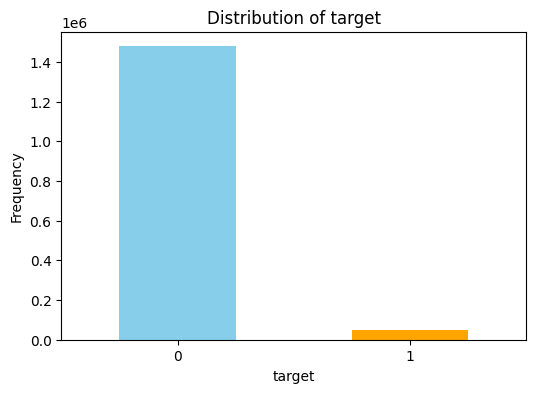

In [19]:
# Plot the distribution of the target variable using a bar plot
plt.figure(figsize=(6, 4))
train_base['target'].value_counts().plot(kind='bar', color=['skyblue', 'orange'])
plt.title('Distribution of target')
plt.xlabel('target')
plt.ylabel('Frequency')
plt.xticks(rotation=0)
plt.show()

## Step 2: Explore depth 0

Train Files:

- train_static_0_0.parquet
- train_static_0_1.parquet
- train_static_cb_0.parquet

Test Files:

- test_static_0_0.parquet
- test_static_0_1.parquet
- test_static_0_2.parquet
- test_static_cb_0.parquet

In [20]:
#train
train_static_0_0 = pd.read_parquet(train_path+"/train_static_0_0.parquet")
train_static_0_1= pd.read_parquet(train_path+ "/train_static_0_1.parquet")
train_static_cb_0= pd.read_parquet(train_path+ "/train_static_cb_0.parquet")
#test
test_static_0_0=pd.read_parquet(test_path+"/test_static_0_0.parquet")
test_static_0_1= pd.read_parquet(test_path+"/test_static_0_1.parquet")
test_static_0_2=pd.read_parquet(test_path+"/test_static_0_2.parquet")
test_static_cb_0= pd.read_parquet(test_path+"/test_static_cb_0.parquet")

In [21]:
train_static_0_0.head()
train_static_cb_0.head()

,case_id,actualdpdtolerance_344P,amtinstpaidbefduel24m_4187115A,annuity_780A,annuitynextmonth_57A,applicationcnt_361L,applications30d_658L,applicationscnt_1086L,applicationscnt_464L,applicationscnt_629L,applicationscnt_867L,avgdbddpdlast24m_3658932P,avgdbddpdlast3m_4187120P,avgdbdtollast24m_4525197P,avgdpdtolclosure24_3658938P,avginstallast24m_3658937A,avglnamtstart24m_4525187A,avgmaxdpdlast9m_3716943P,avgoutstandbalancel6m_4187114A,avgpmtlast12m_4525200A,bankacctype_710L,cardtype_51L,clientscnt12m_3712952L,clientscnt3m_3712950L,clientscnt6m_3712949L,clientscnt_100L,clientscnt_1022L,clientscnt_1071L,clientscnt_1130L,clientscnt_136L,clientscnt_157L,clientscnt_257L,clientscnt_304L,clientscnt_360L,clientscnt_493L,clientscnt_533L,clientscnt_887L,clientscnt_946L,cntincpaycont9m_3716944L,cntpmts24_3658933L,commnoinclast6m_3546845L,credamount_770A,credtype_322L,currdebt_22A,currdebtcredtyperange_828A,datefirstoffer_1144D,datelastinstal40dpd_247D,datelastunpaid_3546854D,daysoverduetolerancedd_3976961L,deferredmnthsnum_166L,disbursedcredamount_1113A,disbursementtype_67L,downpmt_116A,dtlastpmtallstes_4499206D,eir_270L,equalitydataagreement_891L,equalityempfrom_62L,firstclxcampaign_1125D,firstdatedue_489D,homephncnt_628L,inittransactionamount_650A,inittransactioncode_186L,interestrate_311L,interestrategrace_34L,isbidproduct_1095L,isbidproductrequest_292L,isdebitcard_729L,lastactivateddate_801D,lastapplicationdate_877D,lastapprcommoditycat_1041M,lastapprcommoditytypec_5251766M,lastapprcredamount_781A,lastapprdate_640D,lastcancelreason_561M,lastdelinqdate_224D,lastdependentsnum_448L,lastotherinc_902A,lastotherlnsexpense_631A,lastrejectcommoditycat_161M,lastrejectcommodtypec_5251769M,lastrejectcredamount_222A,lastrejectdate_50D,lastrejectreason_759M,lastrejectreasonclient_4145040M,lastrepayingdate_696D,lastst_736L,maininc_215A,mastercontrelectronic_519L,mastercontrexist_109L,maxannuity_159A,maxannuity_4075009A,maxdbddpdlast1m_3658939P,maxdbddpdtollast12m_3658940P,maxdbddpdtollast6m_4187119P,maxdebt4_972A,maxdpdfrom6mto36m_3546853P,maxdpdinstldate_3546855D,maxdpdinstlnum_3546846P,maxdpdlast12m_727P,maxdpdlast24m_143P,maxdpdlast3m_392P,maxdpdlast6m_474P,maxdpdlast9m_1059P,maxdpdtolerance_374P,maxinstallast24m_3658928A,maxlnamtstart6m_4525199A,maxoutstandbalancel12m_4187113A,maxpmtlast3m_4525190A,mindbddpdlast24m_3658935P,mindbdtollast24m_4525191P,mobilephncnt_593L,monthsannuity_845L,numactivecreds_622L,numactivecredschannel_414L,numactiverelcontr_750L,numcontrs3months_479L,numincomingpmts_3546848L,numinstlallpaidearly3d_817L,numinstls_657L,numinstlsallpaid_934L,numinstlswithdpd10_728L,numinstlswithdpd5_4187116L,numinstlswithoutdpd_562L,numinstmatpaidtearly2d_4499204L,numinstpaid_4499208L,numinstpaidearly3d_3546850L,numinstpaidearly3dest_4493216L,numinstpaidearly5d_1087L,numinstpaidearly5dest_4493211L,numinstpaidearly5dobd_4499205L,numinstpaidearly_338L,numinstpaidearlyest_4493214L,numinstpaidlastcontr_4325080L,numinstpaidlate1d_3546852L,numinstregularpaid_973L,numinstregularpaidest_4493210L,numinsttopaygr_769L,numinsttopaygrest_4493213L,numinstunpaidmax_3546851L,numinstunpaidmaxest_4493212L,numnotactivated_1143L,numpmtchanneldd_318L,numrejects9m_859L,opencred_647L,paytype1st_925L,paytype_783L,payvacationpostpone_4187118D,pctinstlsallpaidearl3d_427L,pctinstlsallpaidlat10d_839L,pctinstlsallpaidlate1d_3546856L,pctinstlsallpaidlate4d_3546849L,pctinstlsallpaidlate6d_3546844L,pmtnum_254L,posfpd10lastmonth_333P,posfpd30lastmonth_3976960P,posfstqpd30lastmonth_3976962P,previouscontdistrict_112M,price_1097A,sellerplacecnt_915L,sellerplacescnt_216L,sumoutstandtotal_3546847A,sumoutstandtotalest_4493215A,totaldebt_9A,totalsettled_863A,totinstallast1m_4525188A,twobodfilling_608L,typesuite_864L,validfrom_1069D
0,0,NaN,NaN,1917.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,30000.0,CAL,0.0,0.0,None,None,None,NaN,0.0,30000.0,GBA,0.0,None,0.4500,None,None,N

,case_id,assignmentdate_238D,assignmentdate_4527235D,assignmentdate_4955616D,birthdate_574D,contractssum_5085716L,dateofbirth_337D,dateofbirth_342D,days120_123L,days180_256L,days30_165L,days360_512L,days90_310L,description_5085714M,education_1103M,education_88M,firstquarter_103L,for3years_128L,for3years_504L,for3years_584L,formonth_118L,formonth_206L,formonth_535L,forquarter_1017L,forquarter_462L,forquarter_634L,fortoday_1092L,forweek_1077L,forweek_528L,forweek_601L,foryear_618L,foryear_818L,foryear_850L,fourthquarter_440L,maritalst_385M,maritalst_893M,numberofqueries_373L,pmtaverage_3A,pmtaverage_4527227A,pmtaverage_4955615A,pmtcount_4527229L,pmtcount_4955617L,pmtcount_693L,pmtscount_423L,pmtssum_45A,requesttype_4525192L,responsedate_1012D,responsedate_4527233D,responsedate_4917613D,riskassesment_302T,riskassesment_940T,secondquarter_766L,thirdquarter_1082L
0,357,None,None,None,1988-04-01,NaN,None,None,NaN,NaN,NaN,NaN,NaN,a55475b1,a55475b1,a55475b1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a55475b1,a55475b1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,6301.4000,None,2019-01-25,None,None,None,NaN,NaN,NaN
1,381,None,None,None,1973-11-01,NaN,None,None,NaN,NaN,NaN,NaN,NaN,a55475b1,a55475b1,a55475b1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a55475b1,a55475b1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,4019.6000,None,2019-01-25,None,None,None,NaN,NaN,NaN
2,388,None,None,None,1989-04-01,NaN,1989-04-01,None,6.0,8.0,2.0,10.0,4.0,a55475b1,a55475b1,a55475b1,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0,a55475b1,a55475b1,10.0,NaN,NaN,NaN,NaN,NaN,NaN,6.0,14548.0000,None,2019-01-28,None,None,None,NaN,3.0,5.0
3,405,None,None,None,1974-03-01,NaN,1974-03-01,None,0.0,0.0,0.0,1.0,0.0,a55475b1,a55475b1,a55475b1,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,a55475b1,a55475b1,1.0,NaN,NaN,NaN,NaN,NaN,NaN,6.0,10498.2400,None,2019-01-21,None,None,None,NaN,2.0,0.0
4,409,None,None,None,1993-06-01,NaN,1993-06-01,None,2.0,3.0,0.0,3.0,1.0,a55475b1,717ddd49,a55475b1,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,a7fcb6e5,a55475b1,3.0,NaN,NaN,NaN,NaN,NaN,NaN,7.0,6344.8804,None,2019-01-21,None,None,None,NaN,0.0,4.0


In [22]:
# perform dtype transformation on the static tables

#train data
train_static_0_0= transform_dtypes(train_static_0_0)
train_static_0_1= transform_dtypes(train_static_0_1)
train_static_cb_0=transform_dtypes(train_static_cb_0)

# #test data
test_static_0_0= transform_dtypes(test_static_0_0)
test_static_0_1= transform_dtypes(test_static_0_1)
test_static_0_2= transform_dtypes(test_static_0_2)
test_static_cb_0= transform_dtypes(test_static_cb_0)

In [35]:
#train data
train_static_0_0= convert_strings(train_static_0_0)
train_static_0_1= convert_strings(train_static_0_1)
train_static_cb_0=convert_strings(train_static_cb_0)

# #test data
test_static_0_0= convert_strings(test_static_0_0)
test_static_0_1= convert_strings(test_static_0_1)
test_static_0_2= convert_strings(test_static_0_2)
test_static_cb_0= convert_strings(test_static_cb_0)

In [24]:
def get_column_data_types(df):
    """
    Get the data types of all columns in a DataFrame.

    Parameters:
    - df: DataFrame for which to retrieve data types

    Returns:
    - Dictionary containing column names as keys and their corresponding data 
    types as values
    """
    return df.dtypes.to_dict()

In [ ]:
# get_column_data_types(train_static_0_0)
# get_column_data_types(train_static_cb_0)

In [25]:
def train_test_cols(train, test):
    """
    Find columns unique to train and test DataFrames.

    Parameters:
    - train: DataFrame representing training data
    - test: DataFrame representing testing data

    Returns:
    - Two lists containing columns unique to train and test DataFrames respectively
    """
    train_unique_cols = list(set(train.columns) - set(test.columns))
    test_unique_cols = list(set(test.columns) - set(train.columns))
    
    if not train_unique_cols:
        print("All columns in train are in test")
    if not test_unique_cols:
        print("All columns in test are in train")

    return train_unique_cols, test_unique_cols

In [36]:
static_0= train_test_cols(train_static_0_0, test_static_0_0)
print("----------------------------------------------------------")
static_1= train_test_cols(train_static_0_1, test_static_0_1)
print("----------------------------------------------------------")
static_2= train_test_cols(train_static_0_1, test_static_0_2)
print("----------------------------------------------------------")
static_cb= train_test_cols(train_static_cb_0,test_static_cb_0)
print('----------------------------------------------------------')

All columns in train are in test
All columns in test are in train
----------------------------------------------------------
All columns in train are in test
All columns in test are in train
----------------------------------------------------------
All columns in train are in test
All columns in test are in train
----------------------------------------------------------
All columns in train are in test
All columns in test are in train
----------------------------------------------------------


In [28]:
# Concatenate tables of depth 0
def concatenate_dataframes(df_list):
    """
    Concatenate a list of DataFrames horizontally using Polars.

    Parameters:
    - df_list: List of DataFrames to be concatenated

    Returns:
    - DataFrame resulting from the vertical concatenation
    """
    # Perform vertical concatenation on non-empty DataFrames
    return pd.concat(df_list, axis=0)

In [29]:
#train
df_list_train= [train_static_0_0,train_static_0_1]
train_static= concatenate_dataframes(df_list_train)
#test
df_list_test= [test_static_0_0,test_static_0_1,test_static_0_2]
test_static= concatenate_dataframes(df_list_test)

In [30]:
train_static.shape
test_static.shape

base_train.shape
base_test.shape

(1526659, 168)

(30, 168)

(1526659, 5)

(10, 4)

In [31]:
train_test_cols(train_static, test_static)

All columns in train are in test
All columns in test are in train


([], [])

In [32]:
def join_dataframes(df_base, *dfs_to_join, how="left", on=["case_id"]):
    """
    Join multiple DataFrames to a base DataFrame.

    Parameters:
    - df_base: Base DataFrame to join other DataFrames to
    - dfs_to_join: Variable number of DataFrames to join to the base DataFrame
    - how: Type of join to perform (default is "left")
    - on: Column(s) to join on (default is "case_id")

    Returns:
    - DataFrame resulting from joining all specified DataFrames to the base DataFrame
    """
    df_result = df_base
    for df_to_join in dfs_to_join:
        df_result = pd.merge(df_result, df_to_join, how=how, on=on)
    return df_result

In [37]:
train_data= join_dataframes(train_base,train_static,how="left", on="case_id")

test_data_submission= join_dataframes(test_base,test_static,how="left", on="case_id")

In [38]:
train_data.shape
test_data_submission.shape

(1526659, 172)

(10, 171)

In [39]:
train_test_cols(train_data, test_data_submission)

All columns in test are in train


(['target'], [])

In [40]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1526659 entries, 0 to 1526658
Columns: 172 entries, case_id to validfrom_1069D
dtypes: category(27), datetime64[ns](16), float32(53), float64(64), int64(3), object(9)
memory usage: 1.4+ GB


In [45]:
train_data['amtinstpaidbefduel24m_4187115A']

0                   NaN
1                   NaN
2                   NaN
3                   NaN
4                   NaN
5                   NaN
6                   NaN
7                   NaN
8                   NaN
9                   NaN
10                  NaN
11                  NaN
12                  NaN
13                  NaN
14                  NaN
15                  NaN
16                  NaN
17                  NaN
18                  NaN
19                  NaN
20                  NaN
21                  NaN
22                  NaN
23                  NaN
24                  NaN
25                  NaN
26                  NaN
27                  NaN
28                  NaN
29                  NaN
30                  NaN
31                  NaN
32                  NaN
33                  NaN
34                  NaN
35                  NaN
36                  NaN
37                  NaN
38                  NaN
39                  NaN
40                  NaN
41              

# LightGBM

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.model_selection import StratifiedKFold
import lightgbm as lgb
from sklearn.metrics import roc_auc_score

In [ ]:
params = {
    "boosting_type": "gbdt",
    "objective": "binary",
    "metric": "binary_logloss",
    "learning_rate": 0.1,
    "num_leaves": 16,
    "n_estimators": 1000000,
    "random_state": 123,
    "importance_type": "gain",
    "verbose": 1
}

In [ ]:
metrics = []
imp = pd.DataFrame()

n_splits = 5

kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=123)

for nfold, (train_idx, val_idx) in enumerate(kf.split(X_train, y_train)):
    print('-'*10, nfold, '-'*10)
    
    x_tr, y_tr = X_train.iloc[train_idx], y_train.iloc[train_idx]
    x_va, y_va = X_train.iloc[val_idx], y_train.iloc[val_idx]
    
    print("Train:", x_tr.shape, y_tr.shape)
    print("Valid:", x_va.shape, y_va.shape)
    
    model = lgb.LGBMClassifier(**params)
    model.fit(
        x_tr, 
        y_tr, 
        eval_set=[(x_tr, y_tr), (x_va, y_va)], 
        callbacks=[
            lgb.early_stopping(stopping_rounds=100),
        ]
    )
    
    y_tr_pred = model.predict(x_tr)
    accuracy_tr = accuracy_score(y_tr, y_tr_pred)
    
    y_va_pred = model.predict(x_va)
    accuracy_va = accuracy_score(y_va, y_va_pred)

    print(f'Fold {nfold}, Accuracy_tr: {accuracy_tr}, Accuracy_va: {accuracy_va}')
    
    metrics.append([nfold, accuracy_tr, accuracy_va])
    
    _imp = pd.DataFrame({
        "col": X_train.columns,
        "imp": model.feature_importances_,
        "nfold": nfold
    })
    
    imp = pd.concat([imp, _imp], axis=0, ignore_index=True)

    if nfold == 0:  
# nfold starts at 0, so to stop learning at the first fold, use nfold == 0 as a condition
        break

In [ ]:
metrics = np.array(metrics)
metrics

In [ ]:
print("tr: {:3f}+-{:2f}".format(metrics[:, 1].mean(), metrics[:, 1].std()))
print("va: {:3f}+-{:2f}".format(metrics[:, 2].mean(), metrics[:, 2].std()))

In [ ]:
imp = imp.groupby("col")["imp"].agg(["mean", "std"])
imp.columns = ["imp", "imp_std"]
imp = imp.reset_index(drop=False)
imp.head(20)

# Submission

In [ ]:
# Select columns with categorical data types
categorical_columns = test_data_submission.select_dtypes(include=['category']).shape[1]

# Print the number of categorical columns
print("Number of categorical columns in the test data:", categorical_columns)

In [ ]:
y_pred = model.predict_proba(X_test)[:, 1]

In [ ]:
submission = pd.DataFrame({
    "case_id": test_data_submission["case_id"],
    "score": y_pred
}).set_index('case_id')

submission.to_csv("./submission.csv")

# END

In [ ]:
train_test_cols(train_data,test_data_submission)

In [ ]:
# Delete the dtype category column
train_data_numeric = train_data.select_dtypes(exclude=['category','datetime64[ns]' ])

test_data_submission_numeric = test_data_submission.\
select_dtypes(exclude=['category','datetime64[ns]'])
# Check NaN values and replace with Median
print(train_data.isna().sum())

In [ ]:
train_data_numeric.shape
test_data_submission_numeric.shape

In [ ]:
train_test_cols(train_data_numeric,test_data_submission_numeric)

In [ ]:
def handle_missing_values(df):
    """
    Replace NaNs in numerical columns with median and in categorical columns with mode.

    Parameters:
    - df: DataFrame to handle missing values for

    Returns:
    - DataFrame with missing values replaced
    """
    # Separate numerical and categorical columns
    numerical_cols = df.select_dtypes(include=['number']).columns
    categorical_cols = df.select_dtypes(include=['object', 'category']).columns

    # Replace NaNs in numerical columns with median
    df[numerical_cols] = df[numerical_cols].fillna(df[numerical_cols].median())

    # Replace NaNs in categorical columns with mode
    for col in categorical_cols:
        mode_val = df[col].mode()[0]  # Calculate mode (most frequent value)
        df[col] = df[col].fillna(mode_val)  # Replace NaNs with mode value

    return df

In [ ]:
train_data= handle_missing_values(train_data)
test_data_submission= handle_missing_values(test_data_submission)

In [ ]:
len(test_data_submission.columns)
len(train_data.columns)

In [ ]:
def select_columns_with_all_nan(df):
    """
    Select columns from a DataFrame that contain all NaN values.

    Parameters:
    - df: DataFrame to select columns from

    Returns:
    - columns with all NaN values
    """
    # Use the all() method to check if all values in each column are True
    all_nan_columns = df.isna().all()

    # Select columns with all NaN values
    selected_columns = all_nan_columns[all_nan_columns].index

    return selected_columns


In [ ]:
columns= select_columns_with_all_nan(test_data_submission)
train_data= train_data.drop(columns=columns)

In [ ]:
#sanity check
train_data.isnull().sum()

In [ ]:
#encode the categorical variables
categorical_cols = train_data.select_dtypes(include=['object', 'category']).columns
train_df = pd.get_dummies(train_data, columns = categorical_cols)
test_df_submission= pd.get_dummies(test_data_submission, columns = categorical_cols)

In [ ]:
len(test_df_submission.columns)
len(train_df.columns)

In [ ]:
from sklearn.model_selection import train_test_split, StratifiedGroupKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.metrics import auc, accuracy_score, roc_auc_score

In [ ]:
#Identify X and y
X = train_df.drop("target", axis=1)
y = train_df["target"]

#Create train/ test split

X_train, X_test, y_train, y_test = train_test_split(
  X,y , random_state=42,test_size=0.3, shuffle=True)

In [ ]:
scaler = StandardScaler()  
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

#Testing dataset
#test_X = scaler.transform(test_df_submission)

In [ ]:
#Use logRegCV classifier for a simple first model, get score for test
lr_cv = LogisticRegressionCV(solver="lbfgs",
                             multi_class="ovr",
                             max_iter=1000,
                             n_jobs = -1,
                             cv=5,
                            verbose=0)

# Fit model on Training Dataset
lr_cv.fit(X_train, y_train)

# Testing model on Validation dataset
train_pred = lr_cv.predict_proba(X_test)[:, 1]
score = roc_auc_score(y_test, train_pred)

print("Training score: ", score)

As a next step, we will look at what features are highly correlated (corr>0.9). Features that are highly correlated might be redundant and may not add much value and can lead to overfitting. They may also be computationaly burdensome. 

With that said, it is important to be aware of the potential drawbacks of indiscrimately removing features. In the process of removing features, we may be losing information and reducing the predictive power of the model

In [ ]:
def correlation_matrix(df, transform_func=None):
    """
    Transform data types, select numeric columns, 
    calculate correlation matrix, and plot heatmap.

    Args:
    - df: DataFrame containing the dataset.
    - transform_func: Function to transform data types (default: None).

    Returns:
    - Correlation matrix
    """
    # Apply transformation function if provided
    if transform_func is not None:
        transformed_df = transform_func(df)
    else:
        transformed_df = df
    
    # Select numeric columns
    numeric_columns = transformed_df.select_dtypes(include='number')
    transformed_numeric = transformed_df[list(numeric_columns)]
    
    # Calculate correlation matrix
    correlation_matrix = transformed_numeric.corr()
    return correlation_matrix

In [ ]:
def cor_plot(correlation_matrix): 
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title('Correlation Matrix Heatmap')
    plt.xlabel('Features')
    plt.ylabel('Features')
    plt.show()

In [ ]:
correlation_matrix=correlation_matrix(static_df_train, transform_func=transform_dtypes)
cor_plot(correlation_matrix)

In [ ]:
def select_high_correlation_features(correlation_matrix, threshold=0.9):
    """
    Select features with correlation coefficients of 0.9 or higher.

    Args:
    - correlation_matrix: Correlation matrix DataFrame.
    - threshold: Correlation coefficient threshold (default: 0.8).

    Returns:
    - high_correlation_features: 
    List of features that may be redundant
    """
    # Filter correlation matrix to include only absolute correlation 
    #coefficients >= threshold
    high_correlation_matrix = correlation_matrix[(correlation_matrix.abs() >= threshold)\
                                                 & (correlation_matrix < 1)]
    
    # Get feature pairs with correlation coefficients >= threshold
    high_correlation_features = []
    for col in high_correlation_matrix.columns:
        high_corr_index= high_correlation_matrix[col]\
        [high_correlation_matrix[col].notnull()].index.tolist()
        
        for c in high_corr_index:
            feature_pair = tuple(sorted([col, c])) 
            if feature_pair not in  high_correlation_features:
                high_correlation_features.append(feature_pair)
        redundant_n_features=[c[0] for c in high_correlation_features]
        
    return redundant_n_features

In [ ]:
high_corr_f=select_high_correlation_features(correlation_matrix, threshold=0.9)

In [ ]:
reduced_train_static= static_df_train.drop(high_corr_f, axis=1)
reduced_test_static= static_df_test.drop(high_corr_f, axis=1)
reduced_train_static.shape
reduced_test_static.shape

In [ ]:
re_train_static= reduced_train_static.select_dtypes(exclude=['category','datetime64[ns]' ])
re_test_static= reduced_test_static.select_dtypes(exclude=['category','datetime64[ns]' ])

In [ ]:
def remove_columns_with_high_missing_values(df_train, threshold=0.8):
    """
    Remove columns with a high percentage of missing values.
    
    Parameters:
    - df_train: DataFrame containing the training data
    - threshold: Threshold for the percentage of missing values (default: 0.8)
    
    Returns:
    - List of column names to be removed
    """
    columns_to_remove = [col for col in df_train.columns 
                         if col not in ["target", "case_id", "WEEK_NUM"] 
                         and df_train[col].isna().mean() > threshold]
    
    return columns_to_remove

In [ ]:
low_nan_train= re_train_static.drop(remove_columns_with_high_missing_values(re_train_static),\
                                   axis=1)
low_nan_test= re_test_static.drop(remove_columns_with_high_missing_values(re_test_static),\
                                   axis=1)

In [ ]:
low_nan_test.columns

In [ ]:
def train_test_cols(train, test):
    """
    Ensure that the columns in the test set are the same as those in the train set.

    Parameters:
    - train: DataFrame containing the training data
    - test: DataFrame containing the test data

    Returns:
    - Modified test DataFrame with columns matching those in the train DataFrame
    """
    for col in test.columns:
        if col not in train.columns:
            test.drop(col, axis=1, inplace=True)  # Drop the column in place

    return test

In [ ]:
low_nan_test= train_test_cols(low_nan_train,low_nan_test)

In [ ]:
low_nan_test.info()

In [ ]:
low_nan_train.info()

In [ ]:
df= low_nan_train
filled_df = df.fillna(df.median())

In [ ]:
low_nan_test.info()